# Credit Card Segmentation Using PyCaret

### Bussiness problem

In the marketing area, promotions and product offerings that are not well targeted have a negative impact on the company. Like it will consume resources in terms of energy and time, even financial losses if there are expenses incurred to hold the marketing program. For that we need to build a strategy so that marketing programs can run well and on target.

Now it is clear that marketing strategy is very crucial, including in banking companies. Customer segmentation is one of the most widely used strategies, because it is believed to be able to increase profits because the promotions are right on target. This strategy is considered very effective and efficient in terms of profit, time, and energy.

### Objectives

In this case, customer segmentation is done based on the use of credit cards. We will use the unsupervised machine learning technique which is clustering to to create segmentation.

Clustering in this case uses the `PyCaret` library. `PyCaret` is a machine learning library in Python that makes it very easy for programmers from data preparation to model implementation. This library can be used to perform end-to-end machine learning. This includes imputing missing values, encoding categorical data, feature engineering, hyperparameter tuning, and building models. PyCaret is also very powerful for applying various machine learning methods with a faster time, including clustering. So instead of spending time on coding, we can focus more on the business problem itself.

More details about `PyCaret` Library can refer to the official documentation: https://pycaret.org/

In [ ]:
import plotly.offline as pyo
# Set notebook mode to work in offline
pyo.init_notebook_mode()

## Import Data

The data used is `CC GENERAL.csv` downloaded on local drive from [Kaggle](https://www.kaggle.com/datasets/arjunbhasin2013/ccdata). The following code is reading the data using pandas then creating a preview for the dataset.

In [1]:
import pandas as pd

In [2]:
data = pd.read_csv("CC GENERAL.csv")

In [3]:
data.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


Description of the Dataset:

- `CUSTID` : Identification of Credit Card holder (Categorical)
- `BALANCE` : Balance amount left in their account to make purchases 
- `BALANCEFREQUENCY` : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
- `PURCHASES` : Amount of purchases made from account
- `ONEOFFPURCHASES` : Maximum purchase amount done in one-go
- `INSTALLMENTSPURCHASES` : Amount of purchase done in installment
- `CASHADVANCE` : Cash in advance given by the user
- `PURCHASESFREQUENCY` : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
- `ONEOFFPURCHASESFREQUENCY` : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased)
- `PURCHASESINSTALLMENTSFREQUENCY` : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
- `CASHADVANCEFREQUENCY` : How frequently the cash in advance being paid
- `CASHADVANCETRX` : Number of Transactions made with "Cash in Advanced"
- `PURCHASESTRX` : Numbe of purchase transactions made
- `CREDITLIMIT` : Limit of Credit Card for user
- `PAYMENTS` : Amount of Payment done by user
- `MINIMUM_PAYMENTS` : Minimum amount of payments made by user
- `PRCFULLPAYMENT` : Percent of full payment paid by user
- `TENURE` : Tenure of credit card service for user

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

Based on the inspection, we know that in the `CC GENERAL.csv` data, there are 8950 customers who use credit cards. So the ultimate goal of this case is to group each of these customers.

## Setup PyCaret Environment

After reading and checking the data, the next step is to initialize the `PyCaret` environment using the `setup()` function

This step generates a pipeline that prepares the data for the implementation of the model to be created. In this case, some parameter settings are performed as follows:

- `normalize = True` : due to the different scale ranges between features, scaling is considered necessary
- `ignore_features = ['CUST_ID']` : this column only stores unique values for the customers that are considered unnecessary for clustering
- `session_id = 123` : lock the clustering results so that they are always the same. The session_id is set as 123 for later reproducibility

In [5]:
from pycaret.clustering import *
s = setup(data, normalize = True, ignore_features = ['CUST_ID'], session_id = 123)

,Description,Value
0,session_id,123
1,Original Data,"(8950, 18)"
2,Missing Values,True
3,Numeric Features,16
4,Categorical Features,1
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(8950, 23)"
9,CPU Jobs,-1


## Create Model

The `create_model()` function allows us to easily create and evaluate clustering models. By default, the `create_model()` function creates 4 clusters. If we already know the number of clusters in our data, then we just need to set it by adding the `num_clusters` parameter. In this case since we don't know how many clusters there are, we will use the default values. However we will add the parameter `num_clusters = 4` just for demonstration purposes

There are many clustering algorithms provided by `PyCaret`, to see the list use the `models` function.

In [6]:
models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch
kmodes,K-Modes Clustering,kmodes.kmodes.KModes


After performing the function, a number of performance metrics are generated, including Silhouette, Calinski-Harabasz, and Davies-Bouldin. We will focus on Silhouette Coefficients.

In [7]:
kmeans = create_model('kmeans', num_clusters = 4)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.2081,1706.1655,1.5195,0,0,0


The mean Silhouette Coefficient having a range between -1 and 1. A negative values indicates that the instance has been assigned to the wrong cluster, while a values near to 0 indicates that clusters overlap. On the other hand, a positive values close to 1 indicates the correct assignment. This Silhouette Coefficient is 0.2081 which considered as quite good since we have quite a lot of customers in our data.

## Evaluate Model

The `evaluate_model()` function aims to analyze the model performance of the clustering results. The outcome will display several types of plots, namely Cluster 2D, Cluster 3D, Elbow plot, Silhouette, Distance, and Distribution at once. To do so, you can run the following code.

```
evaluate_model(kmeans)
```

In this project we will show only a few types of plots, for that we can use the `plot_model()` function. The `plot_model()` function is used to create various graphs or visualizations of our model's performance.

The plots that will be shown are 2D cluster, Elbow, and Distirbution.

In [8]:
plot_model(kmeans, plot = 'cluster')

The 2-Dimesion Cluster PCA Plot shows that K-Means divides the cluster well. Based on the results of visual inspection, the four clusters are separated in  satisfactory way, seen from the distribution of groups based on color, it is quite visible. Although there are still some overlapping points.

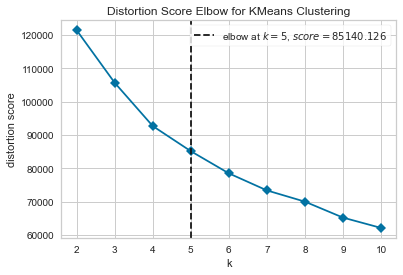

In [9]:
plot_model(kmeans, plot = 'elbow')

The elbow method shows the optimal number of cluster. In this case, the elbow plot suggest that 5 is the optimal number of cluster. Next we will try to create a model using k = 5.

In [10]:
create_model('kmeans', num_clusters = 5)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.2032,1590.2721,1.5011,0,0,0


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)

Because the Silhouette coefficient is smaller than the defalut parameter, we decided to stick with 4 clusters.

The distribution plot provides the graphical the presentation of how many customer of each cluster. 

In [11]:
plot_model(kmeans, plot = 'distribution')

The distribution plot shows the size of each cluster. Cluser 0 has most of the sample, which is almost reach 4000 samples.

## Assign Model

This `assign_model()` function assigns a cluster label to the data. Then a new column will be created, namely `cluster` which indicates which cluster the customer is grouped into.

In [12]:
result = assign_model(kmeans)
result.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,Cluster 1
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,Cluster 2
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,Cluster 3
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12,Cluster 1
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,Cluster 1


## Predict

`PyCaret` also has a function `predict_model()` which aims to predict clusters on new data.

Before making predictions, let's build a dummy data that shows there are 2 new customers who use credit cards.

In [13]:
# initialise data of lists.
new_customer = {'CUST_ID':['C19191', 'C19192'], 'BALANCE':[1564.474828,503.432897], 'BALANCE_FREQUENCY':[1.000000,0.777776],
        'PURCHASES':[1093.25,103.33], 'ONEOFF_PURCHASES':[1093.25,0.00], 'INSTALLMENTS_PURCHASES':[0.0,300.00],
        'CASH_ADVANCE':[6442.945483,0.000000], 'PURCHASES_FREQUENCY':[0.083333,1.000000],
        'ONEOFF_PURCHASES_FREQUENCY':[0.083333,1.000000],'PURCHASES_INSTALLMENTS_FREQUENCY':[0.083333,1.000000],
        'CASH_ADVANCE_FREQUENCY':[0.350000,0.000000], 'CASH_ADVANCE_TRX':[6,2], 'PURCHASES_TRX':[12,1],
        'CREDIT_LIMIT':[10000.0,2000.0], 'PAYMENTS':[5103.032597,401.802084], 'MINIMUM_PAYMENTS':[2072.340217,107.340217],
        'PRC_FULL_PAYMENT':[0.222222,0.000000], 'TENURE':[12,12]}
 
# Create DataFrame
new_data = pd.DataFrame(new_customer)

In [14]:
predictions = predict_model(kmeans, data = new_data                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   )
predictions.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Cluster
0,C19191,1564.474828,1.000000,1093.25,1093.25,0.0,6442.945483,0.083333,0.083333,0.083333,0.35,6,12,10000.0,5103.032597,2072.340217,0.222222,12,Cluster 2
1,C19192,503.432897,0.777776,103.33,0.00,300.0,0.000000,1.000000,1.000000,1.000000,0.00,2,1,2000.0,401.802084,107.340217,0.000000,12,Cluster 3


The prediction was successfully carried out where customers with ID `C19191` were grouped in cluster 2 while customers with ID `C19192` were grouped in cluster 1.

## Save the model

If the model wants to be embed in an application, we can save the `kmeans` model that has been built successfully before using `save_model()` function.

In [15]:
save_model(kmeans, 'kmeans_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True,
                                       features_todrop=['CUST_ID'],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[],
                                       target='UNSUPERVISED_DUMMY_TARGET',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='most frequent',
                                 fill_value_categorical=None,
                                 fill_value_numer...
                 ('fix_perfect', 'passthrough'),
                 ('clean_names', Clean_Colum_Names()),
                 ('feature_select', 'passthrough'), ('fix_multi', 'passthrough'),
                 ('dfs', 'passthrough'), ('pca', 'passthrough'),
                 

## Load Saved Model

Then to call the saved model is very simple, using the `load_model()` function. If the model is considered satisfactory enough, then we just need to embed the model in the application we want to deploy.

In [16]:
loaded_model = load_model('kmeans_pipeline')
print(loaded_model)

Transformation Pipeline and Model Successfully Loaded
Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True,
                                      features_todrop=['CUST_ID'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=[],
                                      target='UNSUPERVISED_DUMMY_TARGET',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                                fill_value_numer...
                ('fix_perfect', 'passthrough'),
                ('clean_names', Clean_Colum_Names()),
                ('feature_select', 'passthrough'), ('fix_multi', 'passthrough'),
                ('dfs', 'passthrough'), ('pc

## Interprating Cluster

Last part on this project is we are going to interpret the characteristics of each cluster by setting specific features on the distribution plot with `plot_model()` function.

In [17]:
plot_model(kmeans, plot = 'distribution', feature='PURCHASES_INSTALLMENTS_FREQUENCY')

> Clusters 0 and 2 are observed to have customers whose purchases in installments are not frequently being done. Meanwhile, clusters 1 and 3 tend to settle their installments frequently.

In [19]:
plot_model(kmeans, plot = 'distribution', feature='CREDIT_LIMIT')

> Cluster 3 has the largest credit card usage limit with a median value of $9000, followed by cluster 2 with a median of $7000. Meanwhile, clusters 0 and 1 have a smaller usage limit with a median value of $2500 and $3000, respectively.

In [20]:
plot_model(kmeans, plot = 'distribution', feature='PAYMENTS')

> Customers in cluster 3 tend to make large payments compared to other clusters.

In [21]:
plot_model(kmeans, plot = 'distribution', feature='BALANCE')

> Another interesting point was found in cluster 2, where the balance amount left in their account was known to be relatively large

> Cluster 2 and cluster 3 are detected to have a balance that tends to be large, but the usage in cluster 2 is relatively smaller than cluster 3

## Conclusion

- Customer segmentation based on credit card usage has been successfully carried out using the `PyCaret` library.
- The resulting optimum cluster is 4 clusters.
- The model successfully performs a cluster prediction on the new dummy data
- Models that have been generated can be saved and embedded in the application.
- Visualization with `plot_model()` is able to show the characteristics shown by each cluster. This can be used by the marketing team to promote and offer products that are more suited to the circumstances of each customer. So that the possibility of customers to accept the offer or promotion is getting bigger.